# Counterfactual Explanations POC - House Prices
**Counterfactual Explanations (CE)** fall under the category of explainable/interpretable AI and Machine Learning Interpretability (MLI) methods. Given a predictive supervised ML model, CE methods explore how feature values could be altered to achieve a different predicted outcome. These methods are typically model-agnostic and allow for control over which features can be modified while keeping others fixed.

This notebook demonstrates how to use DiCE-ML for generating counterfactual explanations in regression problems using the House Prices dataset. We'll show how to explain model predictions and suggest actionable changes to achieve desired house prices.

## 1. Settings

In [1]:
# Import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Preprocessing
from feature_engine.selection import DropFeatures, DropConstantFeatures
from feature_engine.imputation import ArbitraryNumberImputer, CategoricalImputer
from feature_engine.encoding import CountFrequencyEncoder, RareLabelEncoder
from sklearn.pipeline import Pipeline

# Modelling
import lightgbm as lgb
from sklearn.feature_selection import RFECV
import optuna

# Model validation
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.model_selection import train_test_split

# Counterfactuals
import dice_ml

import warnings

warnings.filterwarnings("ignore")

%matplotlib inline

## 2. Data Loading and Exploration

In [2]:
# Load the data (downloaded from Kaggle)
train_df = pd.read_csv("data/train.csv")
test_df = pd.read_csv("data/test.csv")

print(f"Training data shape: {train_df.shape}")
print(f"Test data shape: {test_df.shape}")

Training data shape: (1460, 81)
Test data shape: (1459, 80)


In [3]:
# Display basic information about the dataset
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 81 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1460 non-null   int64  
 1   MSSubClass     1460 non-null   int64  
 2   MSZoning       1460 non-null   object 
 3   LotFrontage    1201 non-null   float64
 4   LotArea        1460 non-null   int64  
 5   Street         1460 non-null   object 
 6   Alley          91 non-null     object 
 7   LotShape       1460 non-null   object 
 8   LandContour    1460 non-null   object 
 9   Utilities      1460 non-null   object 
 10  LotConfig      1460 non-null   object 
 11  LandSlope      1460 non-null   object 
 12  Neighborhood   1460 non-null   object 
 13  Condition1     1460 non-null   object 
 14  Condition2     1460 non-null   object 
 15  BldgType       1460 non-null   object 
 16  HouseStyle     1460 non-null   object 
 17  OverallQual    1460 non-null   int64  
 18  OverallC

In [4]:
# Display summary statistics
train_df.describe()

,Id,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,...,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
count,1460.000000,1460.000000,1201.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1452.000000,1460.000000,...,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000
mean,730.500000,56.897260,70.049958,10516.828082,6.099315,5.575342,1971.267808,1984.865753,103.685262,443.639726,...,94.244521,46.660274,21.954110,3.409589,15.060959,2.758904,43.489041,6.321918,2007.815753,180921.195890
std,421.610009,42.300571,24.284752,9981.264932,1.382997,1.112799,30.202904,20.645407,181.066207,456.098091,...,125.338794,66.256028,61.119149,29.317331,55.757415,40.177307,496.123024,2.703626,1.328095,79442.502883
min,1.000000,20.000000,21.000000,1300.000000,1.000000,1.000000,1872.000000,1950.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,2006.000000,34900.000000
25%,365.750000,20.000000,59.000000,7553.500000,5.000000,5.000000,1954.000000,1967.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5.000000,2007.000000,129975.000000
50%,730.500000,50.000000,69.000000,9478.500000,6.000000,5.000000,1973.000000,1994.000000,0.000000,383.500000,...,0.000000,25.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000,2008.000000,163000.000000
75%,1095.250000,70.000000,80.000000,11601.500000,7.000000,6.000000,2000.000000,2004.000000,166.000000,712.250000,...,168.000000,68.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8.000000,2009.000000,214000.000000
max,1460.000000,190.000000,313.000000,215245.000000,10.000000,9.000000,2010.000000,2010.000000,1600.000000,5644.000000,...,857.000000,547.000000,552.000000,508.000000,480.000000,738.000000,15500.000000,12.000000,2010.000000,755000.000000


In [5]:
# Explore summary statistics of the target
train_df["SalePrice"].describe([0.01, 0.05, 0.25, 0.5, 0.75, 0.95, 0.99])

count      1460.000000
mean     180921.195890
std       79442.502883
min       34900.000000
1%        61815.970000
5%        88000.000000
25%      129975.000000
50%      163000.000000
75%      214000.000000
95%      326100.000000
99%      442567.010000
max      755000.000000
Name: SalePrice, dtype: float64

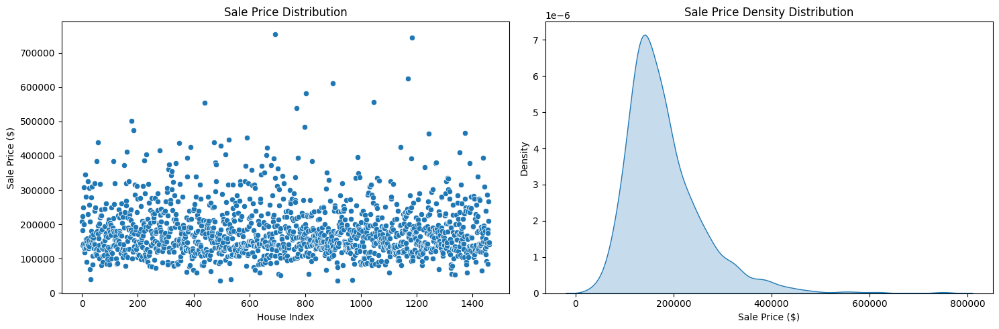

In [6]:
# Create a figure with two subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))

# Scatter plot of SalePrice
sns.scatterplot(data=train_df, x=train_df.index, y="SalePrice", ax=ax1)
ax1.set_title("Sale Price Distribution")
ax1.set_xlabel("House Index")
ax1.set_ylabel("Sale Price ($)")

# Density plot of SalePrice
sns.kdeplot(data=train_df["SalePrice"], ax=ax2, fill=True)
ax2.set_title("Sale Price Density Distribution")
ax2.set_xlabel("Sale Price ($)")
ax2.set_ylabel("Density")

plt.tight_layout()
plt.show()

# NOTE:
# - If interested in creating a robust model, outliers could be handled.
#   For the sake of this notebook, I am mostly interested in the counterfactuals explanations.

In [7]:
# Check for missing values and calculate percentages
missing_values = train_df.isnull().sum()
missing_percentages = (missing_values / len(train_df)) * 100
missing_info = pd.DataFrame(
    {
        "Missing Values": missing_values[missing_values > 0],
        "Percentage": missing_percentages[missing_values > 0],
    }
)
missing_info.sort_values("Missing Values", ascending=False)

# NOTE:
# - Based on the information and for the sake of quick development, a threshold of 80% will be used to remove columns.

,Missing Values,Percentage
PoolQC,1453,99.520548
MiscFeature,1406,96.301370
Alley,1369,93.767123
Fence,1179,80.753425
FireplaceQu,690,47.260274
LotFrontage,259,17.739726
GarageType,81,5.547945
GarageYrBlt,81,5.547945
GarageFinish,81,5.547945
GarageQual,81,5.547945


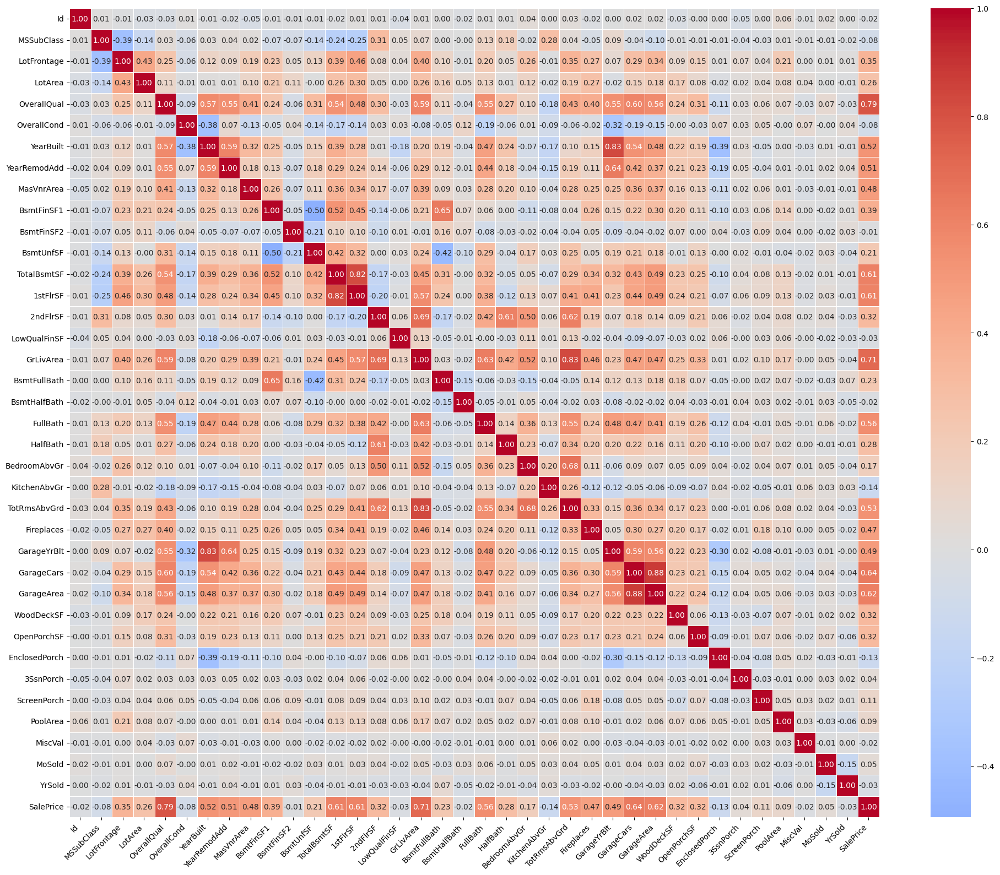

In [8]:
# Calculate correlation matrix for numerical features
correlation_matrix = train_df.corr()

# Create a figure with a larger size
plt.figure(figsize=(20, 16))

# Create heatmap
sns.heatmap(
    correlation_matrix,
    annot=True,  # Show correlation values
    cmap="coolwarm",  # Color scheme
    center=0,  # Center the colormap at 0
    fmt=".2f",  # Format correlation values to 2 decimal places
    square=True,  # Make the plot square
    linewidths=0.5,
)  # Add lines between cells

# Rotate x-axis labels for better readability
plt.xticks(rotation=45, ha="right")
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()

# NOTE:
# - The correlation matrix could be used for two purposes:
#   1. Build intuition on which features might be most important for predicting SalePrice. An exploratory analysis could be conducted further.
#   2. Used for intuitive feature selection to reduce the feature space.

In [9]:
# Print top correlations with SalePrice (i.e. the target)
print("\nTop 10 features most correlated with SalePrice:")
price_correlations = correlation_matrix["SalePrice"].sort_values(ascending=False)
print(price_correlations[1:11])  # Skip first one as it's SalePrice itself


Top 10 features most correlated with SalePrice:
OverallQual     0.790982
GrLivArea       0.708624
GarageCars      0.640409
GarageArea      0.623431
TotalBsmtSF     0.613581
1stFlrSF        0.605852
FullBath        0.560664
TotRmsAbvGrd    0.533723
YearBuilt       0.522897
YearRemodAdd    0.507101
Name: SalePrice, dtype: float64


In [10]:
# Define target variable
TARGET = "SalePrice"

# Separate features and target
X = train_df.drop([TARGET, "Id"], axis=1)
y = train_df[TARGET]

# Split the data
x_train, x_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42
)

print(f"Training set shape: {x_train.shape}")
print(f"Test set shape: {x_test.shape}")

Training set shape: (1168, 79)
Test set shape: (292, 79)


## 3. Feature Engineering and Preprocessing

In [11]:
# 1. Drop columns with 80% missing values
NULL_COLS = [
    "PoolQC",
    "MiscFeature",
    "Alley",
    "Fence",
]
drop_missing_cols_obj = DropFeatures(features_to_drop=NULL_COLS)

# # Apply the transformation
# x_train = drop_missing_cols_obj.fit_transform(x_train)
# x_test = drop_missing_cols_obj.transform(x_test)

In [12]:
# 2. Impute missing values
fill_with_zero_cols = [
    "LotFrontage",
    "GarageYrBlt",
    "MasVnrArea",
    # These are added due to the requirement of the test set containing all rows
    "1stFlrSF",
    "2ndFlrSF",
    "LowQualFinSF",
    "GrLivArea",
    "FullBath",
    "HalfBath",
    "BedroomAbvGr",
    "KitchenAbvGr",
    "TotRmsAbvGrd",
    "Fireplaces",
    "WoodDeckSF",
    "OpenPorchSF",
    "EnclosedPorch",
    "3SsnPorch",
    "ScreenPorch",
    "PoolArea",
    "MiscVal",
    "MoSold",
    "YrSold",
    "OverallQual",
    "OverallCond",
    "YearBuilt",
    "YearRemodAdd",
    "LotArea",
    "BsmtFinSF1",
    "GarageCars",
    "TotalBsmtSF",
    "BsmtUnfSF",
    "BsmtFinSF2",
    "GarageArea",
    "BsmtHalfBath",
    "BsmtFullBath",
    "MSSubClass",
]

# Impute missing values with 0 for specified columns (works only with numerical)
arbitrary_imputer_zero_obj = ArbitraryNumberImputer(
    arbitrary_number=0, variables=fill_with_zero_cols
)

# # Apply the transformation
# x_train = arbitrary_imputer_zero_obj.fit_transform(x_train)
# x_test = arbitrary_imputer_zero_obj.transform(x_test)

# NOTE:
# - Just for ease of calculation, a more robust missing values imputation can be considered.

In [13]:
# 3. Categorical imputation with "missing"
CATEGORICAL_COLS = [
    "GarageType",
    "GarageFinish",
    "GarageQual",
    "GarageCond",
    "BsmtExposure",
    "BsmtFinType2",
    "BsmtFinType1",
    "BsmtCond",
    "BsmtQual",
    "MasVnrType",
    "Electrical",
    "FireplaceQu",
    # These are added due to the requirement of the test set containing all rows
    "CentralAir",
    "HeatingQC",
    "PavedDrive",
    "Heating",
    "SaleCondition",
    "HouseStyle",
    "Condition1",
    "RoofStyle",
    "RoofMatl",
    "Neighborhood",
    "LandSlope",
    "LotConfig",
    "LandContour",
    "ExterQual",
    "ExterCond",
    "Foundation",
    "LotShape",
    "Street",
    "BldgType",
    "Condition2",
    "KitchenQual",
    "Exterior1st",
    "Exterior2nd",
    "SaleType",
    "Utilities",
    "Functional",
    "MSZoning",
]
categorical_imputer_obj = CategoricalImputer(
    imputation_method="missing", fill_value="missing", variables=CATEGORICAL_COLS
)

# # Apply the transformation
# x_train = categorical_imputer_obj.fit_transform(x_train)
# x_test = categorical_imputer_obj.transform(x_test)

In [14]:
# 4. Drop constant features with low variance
drop_constant_features = DropConstantFeatures(
    variables=None,  # Will check all features
    tol=0.9,  # Drop features that show the same value in 90% of the observations
    missing_values="raise",
    confirm_variables=False,
)

# # Apply the transformation
# x_train = drop_constant_features.fit_transform(x_train)
# x_test = drop_constant_features.transform(x_test)

In [15]:
# 5. Encdoe categorical variables
count_freq_encoder = CountFrequencyEncoder(
    encoding_method="count", missing_values="raise", unseen="ignore"
)

# # Apply the transformation
# x_train = count_freq_encoder.fit_transform(x_train)
# x_test = count_freq_encoder.transform(x_test)

In [16]:
# Create a pipeline with all preprocessing steps using pre-defined objects
preprocessing_pipeline = Pipeline(
    [
        ("drop_missing_cols_obj", drop_missing_cols_obj),
        ("arbitrary_imputer_zero_obj", arbitrary_imputer_zero_obj),
        ("categorical_imputer_obj", categorical_imputer_obj),
        ("drop_constant", drop_constant_features),
        ("categorical_encoder", count_freq_encoder),
    ]
)

# Transform the datasets
x_train_transformed = preprocessing_pipeline.fit_transform(x_train)
x_test_transformed = preprocessing_pipeline.transform(x_test)

In [17]:
# Ensure no missing values are left.
print(
    "Missing values in transformed train data:",
    x_train_transformed.isnull().sum().sum(),
)
print(
    "Missing values in transformed test data:", x_test_transformed.isnull().sum().sum()
)

Missing values in transformed train data: 0
Missing values in transformed test data: 0


# 3. Feature Selection

In [18]:
# Initialize base estimator for RFECV
base_estimator = lgb.LGBMRegressor(random_state=42)

# Fit the recursive feature elimination
rfecv = RFECV(
    estimator=base_estimator,
    step=1,
    cv=5,
    scoring="neg_mean_squared_error",
    n_jobs=-1,
    verbose=False,
)
rfecv.fit(x_train_transformed, y_train)

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003043 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003046 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003166 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002846 se

RFECV(cv=5, estimator=LGBMRegressor(random_state=42), n_jobs=-1,
      scoring='neg_mean_squared_error')

In [19]:
# Get selected features
selected_features = x_train_transformed.columns[rfecv.support_].tolist()
print(f"\nNumber of selected features: {len(selected_features)}")
print("\nSelected features:")
print(selected_features)


Number of selected features: 45

Selected features:
['MSSubClass', 'MSZoning', 'LotFrontage', 'LotArea', 'LotShape', 'LotConfig', 'Neighborhood', 'Condition1', 'OverallQual', 'OverallCond', 'YearBuilt', 'YearRemodAdd', 'Exterior1st', 'Exterior2nd', 'MasVnrArea', 'ExterQual', 'BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', '1stFlrSF', '2ndFlrSF', 'GrLivArea', 'BsmtFullBath', 'HalfBath', 'BedroomAbvGr', 'KitchenQual', 'TotRmsAbvGrd', 'Fireplaces', 'FireplaceQu', 'GarageType', 'GarageYrBlt', 'GarageFinish', 'GarageCars', 'GarageArea', 'WoodDeckSF', 'OpenPorchSF', 'EnclosedPorch', 'MoSold', 'YrSold', 'SaleCondition']


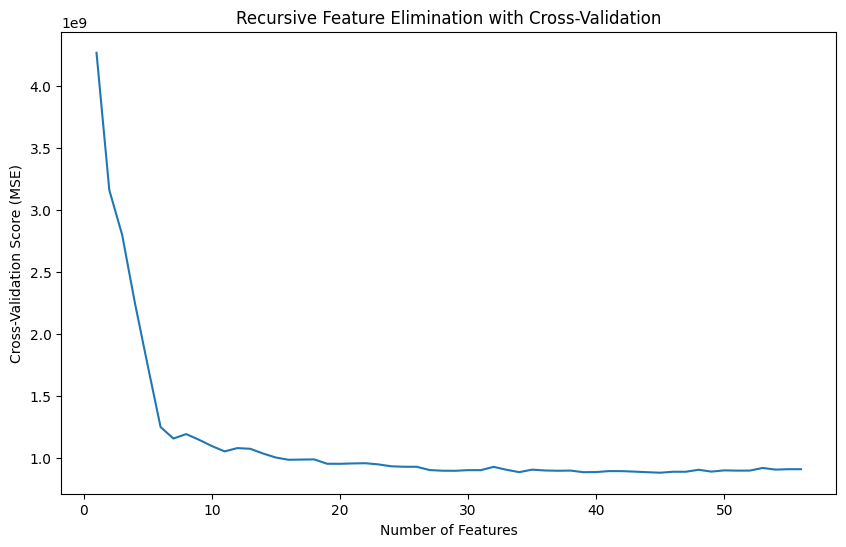

In [20]:
# Plot number of features vs cross-validation score
plt.figure(figsize=(10, 6))
plt.plot(
    range(1, len(rfecv.cv_results_["mean_test_score"]) + 1),
    -rfecv.cv_results_["mean_test_score"],
)
plt.xlabel("Number of Features")
plt.ylabel("Cross-Validation Score (MSE)")
plt.title("Recursive Feature Elimination with Cross-Validation")
plt.show()

In [21]:
# Update processed datasets with selected features
x_train_processed = x_train_transformed[selected_features]
x_test_processed = x_test_transformed[selected_features]

# 4. Hyperparameter Tuning

In [22]:
from sklearn.model_selection import cross_val_score, KFold

# Define the objective function for Optuna using cross-validation


def objective(trial):
    # Define hyperparameter search space
    params = {
        "n_estimators": trial.suggest_int("n_estimators", 100, 1000),
        "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3, log=True),
        "max_depth": trial.suggest_int("max_depth", 3, 12),
        "num_leaves": trial.suggest_int("num_leaves", 20, 100),
        "min_child_samples": trial.suggest_int("min_child_samples", 5, 100),
        "subsample": trial.suggest_float("subsample", 0.6, 1.0),
        "colsample_bytree": trial.suggest_float("colsample_bytree", 0.6, 1.0),
        "reg_alpha": trial.suggest_float("reg_alpha", 1e-8, 10.0, log=True),
        "reg_lambda": trial.suggest_float("reg_lambda", 1e-8, 10.0, log=True),
    }

    # Create model
    model = lgb.LGBMRegressor(**params, random_state=42)

    # Use 5-fold cross validation on training data only
    cv = KFold(n_splits=5, shuffle=True, random_state=42)
    cv_scores = cross_val_score(
        model,
        x_train_processed,
        y_train,
        scoring="neg_root_mean_squared_error",
        cv=cv,
        n_jobs=-1,
    )

    # Return mean RMSE across folds
    return -cv_scores.mean()


# Create Optuna study
study = optuna.create_study(
    direction="minimize", sampler=optuna.samplers.TPESampler(seed=42)
)
study.optimize(objective, n_trials=100)

# Print best parameters and score
print("\nBest parameters:", study.best_params)
print("Best CV RMSE:", study.best_value)

[I 2025-05-20 21:04:42,665] A new study created in memory with name: no-name-23313619-bb5a-404b-8bec-bfcee15cd9d1


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001857 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2776
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002205 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Number of data points in the train set: 934, number of used features: 45
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002074 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2794[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002135 seconds.
You can set `force_row_wise=true` to remove the overhead.
An

[I 2025-05-20 21:05:07,361] Trial 0 finished with value: 29698.398354714715 and parameters: {'n_estimators': 991, 'learning_rate': 0.22581811677618602, 'max_depth': 12, 'num_leaves': 52, 'min_child_samples': 6, 'subsample': 0.6572781233257486, 'colsample_bytree': 0.7976845931379327, 'reg_alpha': 6.434974526083085e-07, 'reg_lambda': 0.004431128255181171}. Best is trial 0 with value: 29698.398354714715.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000822 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2794
[LightGBM] [Info] Number of data points in the train set: 934, number of used features: 45
[LightGBM] [Info] Start training from score 182088.007495
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000775 seconds.
You can set `force_row_wise=true` to 

[I 2025-05-20 21:05:09,004] Trial 1 finished with value: 28701.536042867898 and parameters: {'n_estimators': 258, 'learning_rate': 0.29889253733798604, 'max_depth': 3, 'num_leaves': 77, 'min_child_samples': 50, 'subsample': 0.8602931900994604, 'colsample_bytree': 0.757855591584914, 'reg_alpha': 4.9100037446430973e-05, 'reg_lambda': 1.425479529519658e-08}. Best is trial 1 with value: 28701.536042867898.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001165 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2776
[LightGBM] [Info] Number of data points in the train set: 934, number of used features: 45
[LightGBM] [Info] Start training from score 181034.540685
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001259 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2794
[LightGBM] [Info] Number of data points in the train set: 934, number of used features: 45
[LightGBM] [Info] Start training from score 182088.007495
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003533 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not

[I 2025-05-20 21:05:12,444] Trial 2 finished with value: 28466.12456138371 and parameters: {'n_estimators': 521, 'learning_rate': 0.015830735497697465, 'max_depth': 6, 'num_leaves': 71, 'min_child_samples': 35, 'subsample': 0.6874223854665565, 'colsample_bytree': 0.7974020813250415, 'reg_alpha': 1.8913823133373334e-08, 'reg_lambda': 7.533499490852749e-07}. Best is trial 2 with value: 28466.12456138371.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[LightGBM] [Warning] No f

[I 2025-05-20 21:05:13,826] Trial 3 finished with value: 28382.360746298218 and parameters: {'n_estimators': 253, 'learning_rate': 0.107377909355266, 'max_depth': 6, 'num_leaves': 93, 'min_child_samples': 75, 'subsample': 0.8705359004646889, 'colsample_bytree': 0.8439275667898556, 'reg_alpha': 1.2176895289386267, 'reg_lambda': 4.259550238316379e-06}. Best is trial 3 with value: 28382.360746298218.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:05:16,134] Trial 4 finished with value: 28628.789837632048 and parameters: {'n_estimators': 422, 'learning_rate': 0.030970553044773294, 'max_depth': 6, 'num_leaves': 20, 'min_child_samples': 50, 'subsample': 0.6753763676044318, 'colsample_bytree': 0.8439834762646256, 'reg_alpha': 0.009406372152811697, 'reg_lambda': 1.267899657017279e-05}. Best is trial 3 with value: 28382.360746298218.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:05:20,441] Trial 5 finished with value: 28838.310139798596 and parameters: {'n_estimators': 506, 'learning_rate': 0.016716583199285928, 'max_depth': 12, 'num_leaves': 24, 'min_child_samples': 48, 'subsample': 0.9680906304229346, 'colsample_bytree': 0.8841541489883571, 'reg_alpha': 1.9164968058909506e-07, 'reg_lambda': 8.091265899790026e-05}. Best is trial 3 with value: 28382.360746298218.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:05:23,116] Trial 6 finished with value: 29150.280736618955 and parameters: {'n_estimators': 382, 'learning_rate': 0.01636526629169716, 'max_depth': 7, 'num_leaves': 46, 'min_child_samples': 43, 'subsample': 0.9322616219514797, 'colsample_bytree': 0.9304342891911056, 'reg_alpha': 2.008896899220299e-07, 'reg_lambda': 0.00015751884424362015}. Best is trial 3 with value: 28382.360746298218.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:05:28,622] Trial 7 finished with value: 29610.061004272786 and parameters: {'n_estimators': 778, 'learning_rate': 0.2553966715317418, 'max_depth': 9, 'num_leaves': 34, 'min_child_samples': 67, 'subsample': 0.759454096845554, 'colsample_bytree': 0.6291004493076162, 'reg_alpha': 0.020280006206037572, 'reg_lambda': 1.450197479181383e-06}. Best is trial 3 with value: 28382.360746298218.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:05:37,254] Trial 8 finished with value: 30538.494475239917 and parameters: {'n_estimators': 907, 'learning_rate': 0.07778940177735925, 'max_depth': 10, 'num_leaves': 48, 'min_child_samples': 25, 'subsample': 0.8034905507520546, 'colsample_bytree': 0.6470412938017933, 'reg_alpha': 6.2994869326644425, 'reg_lambda': 0.00036465924890733293}. Best is trial 3 with value: 28382.360746298218.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:05:43,217] Trial 9 finished with value: 28236.52624777429 and parameters: {'n_estimators': 600, 'learning_rate': 0.13500224100916786, 'max_depth': 8, 'num_leaves': 90, 'min_child_samples': 12, 'subsample': 0.9657905940092502, 'colsample_bytree': 0.9938653626175582, 'reg_alpha': 0.3142941665750331, 'reg_lambda': 0.0033353634528897054}. Best is trial 9 with value: 28236.52624777429.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:05:45,012] Trial 10 finished with value: 29422.071119171433 and parameters: {'n_estimators': 691, 'learning_rate': 0.1254317852853282, 'max_depth': 3, 'num_leaves': 96, 'min_child_samples': 96, 'subsample': 0.9803868206194816, 'colsample_bytree': 0.9783817012324311, 'reg_alpha': 0.0657518049139178, 'reg_lambda': 9.189643630806724}. Best is trial 9 with value: 28236.52624777429.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:05:45,827] Trial 11 finished with value: 29401.483115543575 and parameters: {'n_estimators': 121, 'learning_rate': 0.10218833825550148, 'max_depth': 8, 'num_leaves': 99, 'min_child_samples': 79, 'subsample': 0.8762371897491557, 'colsample_bytree': 0.9869311324728426, 'reg_alpha': 3.3479857161243034, 'reg_lambda': 0.05866803706793331}. Best is trial 9 with value: 28236.52624777429.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:05:48,756] Trial 12 finished with value: 28140.358420529217 and parameters: {'n_estimators': 684, 'learning_rate': 0.05327069195972823, 'max_depth': 5, 'num_leaves': 86, 'min_child_samples': 71, 'subsample': 0.9045743039992719, 'colsample_bytree': 0.7323097210929296, 'reg_alpha': 0.2786216944940441, 'reg_lambda': 0.0885649820577411}. Best is trial 12 with value: 28140.358420529217.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:05:52,692] Trial 13 finished with value: 27179.4974011426 and parameters: {'n_estimators': 687, 'learning_rate': 0.04967333647610418, 'max_depth': 4, 'num_leaves': 78, 'min_child_samples': 7, 'subsample': 0.9281592540995346, 'colsample_bytree': 0.713493492135943, 'reg_alpha': 0.0002849054323803852, 'reg_lambda': 0.17207097795646098}. Best is trial 13 with value: 27179.4974011426.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:05:55,454] Trial 14 finished with value: 28118.400042958518 and parameters: {'n_estimators': 768, 'learning_rate': 0.03911178274656495, 'max_depth': 4, 'num_leaves': 76, 'min_child_samples': 67, 'subsample': 0.9116063562445685, 'colsample_bytree': 0.7024851942917744, 'reg_alpha': 0.0002938057843509917, 'reg_lambda': 1.7492551262117466}. Best is trial 13 with value: 27179.4974011426.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:05:58,478] Trial 15 finished with value: 29083.006331875822 and parameters: {'n_estimators': 855, 'learning_rate': 0.037002690423187753, 'max_depth': 4, 'num_leaves': 71, 'min_child_samples': 92, 'subsample': 0.8124067519878453, 'colsample_bytree': 0.6899553493384012, 'reg_alpha': 0.0002397675225310369, 'reg_lambda': 5.16670956574546}. Best is trial 13 with value: 27179.4974011426.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:06:01,171] Trial 16 finished with value: 28066.936192110927 and parameters: {'n_estimators': 745, 'learning_rate': 0.02852521523019189, 'max_depth': 4, 'num_leaves': 60, 'min_child_samples': 64, 'subsample': 0.7330493461062889, 'colsample_bytree': 0.6962135289410745, 'reg_alpha': 1.0419602026365223e-05, 'reg_lambda': 0.43840066309242814}. Best is trial 13 with value: 27179.4974011426.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:06:04,225] Trial 17 finished with value: 27551.443165114477 and parameters: {'n_estimators': 618, 'learning_rate': 0.02396504504895642, 'max_depth': 4, 'num_leaves': 65, 'min_child_samples': 22, 'subsample': 0.7417991157983735, 'colsample_bytree': 0.6095987093755235, 'reg_alpha': 7.028428343195345e-06, 'reg_lambda': 0.26434158272748814}. Best is trial 13 with value: 27179.4974011426.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:06:07,644] Trial 18 finished with value: 28012.314913607854 and parameters: {'n_estimators': 600, 'learning_rate': 0.024346573220320307, 'max_depth': 5, 'num_leaves': 64, 'min_child_samples': 20, 'subsample': 0.6232575387952739, 'colsample_bytree': 0.6178363768235353, 'reg_alpha': 3.68230650101583e-06, 'reg_lambda': 0.005534464235922572}. Best is trial 13 with value: 27179.4974011426.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:06:09,109] Trial 19 finished with value: 28853.882564459986 and parameters: {'n_estimators': 414, 'learning_rate': 0.012070720280132645, 'max_depth': 3, 'num_leaves': 82, 'min_child_samples': 30, 'subsample': 0.7540883649054552, 'colsample_bytree': 0.6603283911540483, 'reg_alpha': 0.0017194503852774935, 'reg_lambda': 0.07597797970079752}. Best is trial 13 with value: 27179.4974011426.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:06:13,443] Trial 20 finished with value: 27357.49402184817 and parameters: {'n_estimators': 620, 'learning_rate': 0.056759280375195155, 'max_depth': 5, 'num_leaves': 57, 'min_child_samples': 14, 'subsample': 0.8339079179344755, 'colsample_bytree': 0.6045524774200534, 'reg_alpha': 2.8081255505487733e-05, 'reg_lambda': 0.3792377570363043}. Best is trial 13 with value: 27179.4974011426.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:06:17,276] Trial 21 finished with value: 28707.8942164945 and parameters: {'n_estimators': 625, 'learning_rate': 0.057198600569719246, 'max_depth': 5, 'num_leaves': 59, 'min_child_samples': 17, 'subsample': 0.8267904618196064, 'colsample_bytree': 0.6117454733122627, 'reg_alpha': 4.1251038090707084e-05, 'reg_lambda': 0.2284998005283374}. Best is trial 13 with value: 27179.4974011426.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:06:20,536] Trial 22 finished with value: 26888.80848513661 and parameters: {'n_estimators': 493, 'learning_rate': 0.04882509932135151, 'max_depth': 4, 'num_leaves': 66, 'min_child_samples': 5, 'subsample': 0.7175194017097437, 'colsample_bytree': 0.6642833736703131, 'reg_alpha': 0.0014599248809058758, 'reg_lambda': 0.017271973806089084}. Best is trial 22 with value: 26888.80848513661.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:06:24,423] Trial 23 finished with value: 27338.831706295394 and parameters: {'n_estimators': 481, 'learning_rate': 0.057955308301701654, 'max_depth': 5, 'num_leaves': 40, 'min_child_samples': 7, 'subsample': 0.7122393077354662, 'colsample_bytree': 0.744169509641528, 'reg_alpha': 0.0021951780442061595, 'reg_lambda': 0.02024780349504489}. Best is trial 22 with value: 26888.80848513661.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:06:28,020] Trial 24 finished with value: 29156.457243696837 and parameters: {'n_estimators': 321, 'learning_rate': 0.07492719936116314, 'max_depth': 7, 'num_leaves': 39, 'min_child_samples': 6, 'subsample': 0.7082736631131064, 'colsample_bytree': 0.7492867483212609, 'reg_alpha': 0.0023533541759682935, 'reg_lambda': 0.012191201163496236}. Best is trial 22 with value: 26888.80848513661.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000890 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2776
[LightGBM] [Info] Number of data points in the train set: 934, number of used features: 45
[LightGBM] [Info] Start training from score 181034.540685
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001171 seconds.
You can set `force_row_wis

[I 2025-05-20 21:06:29,742] Trial 25 finished with value: 28265.47550953201 and parameters: {'n_estimators': 482, 'learning_rate': 0.04480407110555015, 'max_depth': 3, 'num_leaves': 31, 'min_child_samples': 5, 'subsample': 0.7787385106352305, 'colsample_bytree': 0.7304562191549299, 'reg_alpha': 0.002223841266295119, 'reg_lambda': 0.024418361962869842}. Best is trial 22 with value: 26888.80848513661.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:06:32,369] Trial 26 finished with value: 28933.465547613807 and parameters: {'n_estimators': 471, 'learning_rate': 0.07475432131272763, 'max_depth': 6, 'num_leaves': 41, 'min_child_samples': 33, 'subsample': 0.6106472297046855, 'colsample_bytree': 0.7771709653577016, 'reg_alpha': 0.0005495749441665414, 'reg_lambda': 0.001385495957860753}. Best is trial 22 with value: 26888.80848513661.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:06:34,150] Trial 27 finished with value: 27310.351435052882 and parameters: {'n_estimators': 329, 'learning_rate': 0.1556284739804427, 'max_depth': 4, 'num_leaves': 70, 'min_child_samples': 12, 'subsample': 0.7069612034922707, 'colsample_bytree': 0.6780114594177503, 'reg_alpha': 0.013380691350633833, 'reg_lambda': 0.001134544430177011}. Best is trial 22 with value: 26888.80848513661.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:06:35,021] Trial 28 finished with value: 28615.572837422667 and parameters: {'n_estimators': 195, 'learning_rate': 0.17867468591851243, 'max_depth': 4, 'num_leaves': 70, 'min_child_samples': 40, 'subsample': 0.6447853608330814, 'colsample_bytree': 0.6655222122117175, 'reg_alpha': 0.01865285691648078, 'reg_lambda': 0.0008143232722114072}. Best is trial 22 with value: 26888.80848513661.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:06:39,152] Trial 29 finished with value: 30554.259698948073 and parameters: {'n_estimators': 359, 'learning_rate': 0.15842550922685283, 'max_depth': 12, 'num_leaves': 54, 'min_child_samples': 26, 'subsample': 0.6547666802768133, 'colsample_bytree': 0.6804472862311997, 'reg_alpha': 0.12043296347392832, 'reg_lambda': 1.51974853671589}. Best is trial 22 with value: 26888.80848513661.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001296 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2776
[LightGBM] [Info] Number of data points in the train set: 934, number of used features: 45
[LightGBM] [Info] Start training from score 181034.540685
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001588 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2774
[LightGBM] [Info] Number of data points in the train set: 934, number of used features: 45
[Lig

[I 2025-05-20 21:06:43,396] Trial 30 finished with value: 29884.504190653843 and parameters: {'n_estimators': 297, 'learning_rate': 0.19800888491164884, 'max_depth': 11, 'num_leaves': 81, 'min_child_samples': 13, 'subsample': 0.7848535117693575, 'colsample_bytree': 0.7135430645037965, 'reg_alpha': 0.007052986354557745, 'reg_lambda': 0.003725093773475642}. Best is trial 22 with value: 26888.80848513661.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:06:48,759] Trial 31 finished with value: 27943.575171076624 and parameters: {'n_estimators': 548, 'learning_rate': 0.08397599628145502, 'max_depth': 5, 'num_leaves': 68, 'min_child_samples': 5, 'subsample': 0.7172812000032611, 'colsample_bytree': 0.6491890448256272, 'reg_alpha': 0.00041919322526090406, 'reg_lambda': 0.018997518544243575}. Best is trial 22 with value: 26888.80848513661.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:06:51,018] Trial 32 finished with value: 27132.45312939423 and parameters: {'n_estimators': 445, 'learning_rate': 0.041527907387265556, 'max_depth': 4, 'num_leaves': 75, 'min_child_samples': 10, 'subsample': 0.6976882381851365, 'colsample_bytree': 0.7235162500581208, 'reg_alpha': 0.00013562521797683036, 'reg_lambda': 0.001742042085985262}. Best is trial 22 with value: 26888.80848513661.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000946 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2776
[LightGBM] [Info] Number of data points in the train set: 934, number of used features: 45
[LightGBM] [Info] Start training from score 181034.540685
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000925 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2774
[LightGBM] [Info] Number of data points in the train set: 934, number of used features: 45
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Start training from score 180420.686296
[LightGBM] [Warning] No further 

[I 2025-05-20 21:06:52,532] Trial 33 finished with value: 27434.3288645442 and parameters: {'n_estimators': 418, 'learning_rate': 0.04280425842150526, 'max_depth': 3, 'num_leaves': 76, 'min_child_samples': 14, 'subsample': 0.6704125333336, 'colsample_bytree': 0.7690670336132706, 'reg_alpha': 9.394854333222554e-05, 'reg_lambda': 4.420572246667265e-05}. Best is trial 22 with value: 26888.80848513661.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:06:53,611] Trial 34 finished with value: 28094.923929781624 and parameters: {'n_estimators': 215, 'learning_rate': 0.06487203059305348, 'max_depth': 4, 'num_leaves': 80, 'min_child_samples': 20, 'subsample': 0.6943616010177357, 'colsample_bytree': 0.8070758025007024, 'reg_alpha': 0.00010870191524947506, 'reg_lambda': 0.0010861043393329429}. Best is trial 22 with value: 26888.80848513661.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:06:58,170] Trial 35 finished with value: 27401.57614368735 and parameters: {'n_estimators': 548, 'learning_rate': 0.03283442592301058, 'max_depth': 6, 'num_leaves': 73, 'min_child_samples': 11, 'subsample': 0.6341037339904897, 'colsample_bytree': 0.7180452409365092, 'reg_alpha': 0.0009414121941802227, 'reg_lambda': 2.008930146097285e-05}. Best is trial 22 with value: 26888.80848513661.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:06:59,348] Trial 36 finished with value: 28070.164033856603 and parameters: {'n_estimators': 308, 'learning_rate': 0.021177760215459404, 'max_depth': 3, 'num_leaves': 63, 'min_child_samples': 26, 'subsample': 0.6847376092010864, 'colsample_bytree': 0.6770606898842562, 'reg_alpha': 0.016536112418097364, 'reg_lambda': 2.2945080318472897e-07}. Best is trial 22 with value: 26888.80848513661.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:07:01,901] Trial 37 finished with value: 28511.82698076883 and parameters: {'n_estimators': 355, 'learning_rate': 0.046124581181089176, 'max_depth': 6, 'num_leaves': 87, 'min_child_samples': 57, 'subsample': 0.7632499538118963, 'colsample_bytree': 0.8118755210447278, 'reg_alpha': 1.0519061305206161e-06, 'reg_lambda': 0.00024188089688661427}. Best is trial 22 with value: 26888.80848513661.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000649 secon

[I 2025-05-20 21:07:04,900] Trial 38 finished with value: 27101.27231744831 and parameters: {'n_estimators': 449, 'learning_rate': 0.0925489055837186, 'max_depth': 4, 'num_leaves': 67, 'min_child_samples': 9, 'subsample': 0.9983775751517425, 'colsample_bytree': 0.6383462353403323, 'reg_alpha': 0.004908260409938716, 'reg_lambda': 5.197180850406871e-08}. Best is trial 22 with value: 26888.80848513661.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000943 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2776
[LightGBM] [Info] Number of data points in the train set: 934, number of used features: 45
[LightGBM] [Info] Start training from score 181034.540685
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001525 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2794
[LightGBM] [Info] Number of data points in the train set: 934, number of used features: 45
[LightGBM] [Info] Start training from score 182088.007495
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001491 s

[I 2025-05-20 21:07:09,637] Trial 39 finished with value: 29209.40619500702 and parameters: {'n_estimators': 685, 'learning_rate': 0.09630013649862694, 'max_depth': 7, 'num_leaves': 52, 'min_child_samples': 39, 'subsample': 0.9178739763161161, 'colsample_bytree': 0.6347321603581819, 'reg_alpha': 1.6157429479188793e-05, 'reg_lambda': 1.352934445885298e-08}. Best is trial 22 with value: 26888.80848513661.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:07:11,081] Trial 40 finished with value: 28016.006517645426 and parameters: {'n_estimators': 446, 'learning_rate': 0.048932859529951966, 'max_depth': 3, 'num_leaves': 66, 'min_child_samples': 18, 'subsample': 0.9429395835255582, 'colsample_bytree': 0.7888724356337806, 'reg_alpha': 1.1942655580591232e-08, 'reg_lambda': 8.363116335907292e-08}. Best is trial 22 with value: 26888.80848513661.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:07:14,021] Trial 41 finished with value: 26539.700133585866 and parameters: {'n_estimators': 531, 'learning_rate': 0.12248264460454596, 'max_depth': 4, 'num_leaves': 75, 'min_child_samples': 10, 'subsample': 0.9572721310840198, 'colsample_bytree': 0.6411519116509377, 'reg_alpha': 0.005671237191868646, 'reg_lambda': 7.354930479902484e-06}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:07:16,736] Trial 42 finished with value: 27075.942474406602 and parameters: {'n_estimators': 513, 'learning_rate': 0.12072951552905144, 'max_depth': 4, 'num_leaves': 75, 'min_child_samples': 10, 'subsample': 0.9947230686889643, 'colsample_bytree': 0.6374637217939065, 'reg_alpha': 0.00524679987729362, 'reg_lambda': 5.037180671924576e-06}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:07:20,975] Trial 43 finished with value: 28413.54623702597 and parameters: {'n_estimators': 542, 'learning_rate': 0.13223508361766811, 'max_depth': 5, 'num_leaves': 74, 'min_child_samples': 10, 'subsample': 0.9951104699611364, 'colsample_bytree': 0.6395658646075704, 'reg_alpha': 0.05658811550244384, 'reg_lambda': 5.396534709173648e-06}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:07:22,825] Trial 44 finished with value: 29986.96667881874 and parameters: {'n_estimators': 508, 'learning_rate': 0.2988003377260876, 'max_depth': 3, 'num_leaves': 83, 'min_child_samples': 17, 'subsample': 0.9564080235318144, 'colsample_bytree': 0.6599593475368624, 'reg_alpha': 0.00426343459401262, 'reg_lambda': 1.399893810601259e-06}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:07:24,750] Trial 45 finished with value: 27936.294990075217 and parameters: {'n_estimators': 393, 'learning_rate': 0.11000578211788378, 'max_depth': 4, 'num_leaves': 74, 'min_child_samples': 23, 'subsample': 0.9901274752331907, 'colsample_bytree': 0.6284405648562068, 'reg_alpha': 0.03791817581781005, 'reg_lambda': 6.163182968507222e-08}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:07:28,079] Trial 46 finished with value: 28836.387043237926 and parameters: {'n_estimators': 579, 'learning_rate': 0.08602109800639697, 'max_depth': 6, 'num_leaves': 86, 'min_child_samples': 32, 'subsample': 0.9692845164840745, 'colsample_bytree': 0.6470409229543267, 'reg_alpha': 0.004930076164597506, 'reg_lambda': 3.2232768673854293e-07}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:07:31,668] Trial 47 finished with value: 28079.937463552204 and parameters: {'n_estimators': 507, 'learning_rate': 0.06603820045616832, 'max_depth': 5, 'num_leaves': 93, 'min_child_samples': 9, 'subsample': 0.8784113820460153, 'colsample_bytree': 0.8894946135493486, 'reg_alpha': 0.0010173785632709405, 'reg_lambda': 7.418398864931719e-06}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:07:35,835] Trial 48 finished with value: 29606.7201315041 and parameters: {'n_estimators': 442, 'learning_rate': 0.11307415180496673, 'max_depth': 9, 'num_leaves': 61, 'min_child_samples': 29, 'subsample': 0.9415472417440334, 'colsample_bytree': 0.6265258730012823, 'reg_alpha': 0.287283750202183, 'reg_lambda': 5.413192668745086e-05}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:07:38,964] Trial 49 finished with value: 27376.60213012647 and parameters: {'n_estimators': 580, 'learning_rate': 0.0950489720492505, 'max_depth': 4, 'num_leaves': 67, 'min_child_samples': 16, 'subsample': 0.898169039123881, 'colsample_bytree': 0.6016682141520366, 'reg_alpha': 8.42059190045672e-05, 'reg_lambda': 1.1189124823222765e-06}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:07:42,539] Trial 50 finished with value: 30477.972884589526 and parameters: {'n_estimators': 981, 'learning_rate': 0.2157079174364663, 'max_depth': 4, 'num_leaves': 78, 'min_child_samples': 87, 'subsample': 0.999283315678036, 'colsample_bytree': 0.6662369954367101, 'reg_alpha': 0.1218494897160748, 'reg_lambda': 4.207023995405456e-08}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.041995 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2776
[LightGBM] [Info] Number of data points in the train set: 934, number of used features: 45
[LightGBM] [Info] Start training from score 181034.540685
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001340 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2794
[LightGBM] [Info] Number of data points in the train set: 934, number of used features: 45
[LightGBM] [Info] Start training from score 182088.007495
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003567 seconds.
You

[I 2025-05-20 21:07:46,442] Trial 51 finished with value: 26845.997511519865 and parameters: {'n_estimators': 650, 'learning_rate': 0.032255219536546156, 'max_depth': 4, 'num_leaves': 77, 'min_child_samples': 5, 'subsample': 0.9752992242502885, 'colsample_bytree': 0.7055875699243189, 'reg_alpha': 0.00018667113849731086, 'reg_lambda': 0.00010068523770126295}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:07:48,729] Trial 52 finished with value: 27281.23571184763 and parameters: {'n_estimators': 662, 'learning_rate': 0.03421752106112569, 'max_depth': 3, 'num_leaves': 73, 'min_child_samples': 9, 'subsample': 0.9581450169136045, 'colsample_bytree': 0.7020987565857509, 'reg_alpha': 0.00015261807383905047, 'reg_lambda': 0.00010902063051047415}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:07:53,563] Trial 53 finished with value: 27279.22465137594 and parameters: {'n_estimators': 456, 'learning_rate': 0.02976890670408258, 'max_depth': 5, 'num_leaves': 78, 'min_child_samples': 5, 'subsample': 0.9692181255031033, 'colsample_bytree': 0.6900907891070348, 'reg_alpha': 0.0008847181222236796, 'reg_lambda': 1.9317920932482988e-05}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:07:58,055] Trial 54 finished with value: 27061.67498741499 and parameters: {'n_estimators': 721, 'learning_rate': 0.0672401353445958, 'max_depth': 4, 'num_leaves': 69, 'min_child_samples': 10, 'subsample': 0.9799157223112737, 'colsample_bytree': 0.6523997047369318, 'reg_alpha': 0.005743145500803318, 'reg_lambda': 3.3045472028463996e-06}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:08:01,056] Trial 55 finished with value: 27036.566809549135 and parameters: {'n_estimators': 744, 'learning_rate': 0.11945706721005495, 'max_depth': 3, 'num_leaves': 69, 'min_child_samples': 13, 'subsample': 0.9756489727019793, 'colsample_bytree': 0.6217719800858944, 'reg_alpha': 0.006263272782292918, 'reg_lambda': 3.085337777673591e-06}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:08:03,592] Trial 56 finished with value: 27334.126313578814 and parameters: {'n_estimators': 735, 'learning_rate': 0.1530617526754145, 'max_depth': 3, 'num_leaves': 63, 'min_child_samples': 22, 'subsample': 0.978127081945148, 'colsample_bytree': 0.6203078667941879, 'reg_alpha': 0.807958858214375, 'reg_lambda': 2.583612604022866e-06}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000825 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2776
[LightGBM] [Info] Number of data points in the train set: 934, number of used features: 45
[LightGBM] [Info] Start training from score 181034.540685
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.005736 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2794
[LightGBM] [Info] Number of data points in the train set: 934, number of used features: 45
[LightGBM] [Info] Start training from score 182088.007495
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Aut

[I 2025-05-20 21:08:06,746] Trial 57 finished with value: 27016.025346066534 and parameters: {'n_estimators': 873, 'learning_rate': 0.12262001392665836, 'max_depth': 3, 'num_leaves': 70, 'min_child_samples': 15, 'subsample': 0.9398769810742094, 'colsample_bytree': 0.6499234620289925, 'reg_alpha': 0.03072127260313779, 'reg_lambda': 5.559833359317987e-07}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:08:09,570] Trial 58 finished with value: 27471.02691944795 and parameters: {'n_estimators': 810, 'learning_rate': 0.06833743641325331, 'max_depth': 3, 'num_leaves': 56, 'min_child_samples': 16, 'subsample': 0.9428333303308487, 'colsample_bytree': 0.6537484023925594, 'reg_alpha': 0.033011360700058716, 'reg_lambda': 7.958300068757667e-07}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:08:11,917] Trial 59 finished with value: 27593.6748245406 and parameters: {'n_estimators': 847, 'learning_rate': 0.13578084220697811, 'max_depth': 3, 'num_leaves': 60, 'min_child_samples': 56, 'subsample': 0.9305395484319963, 'colsample_bytree': 0.6726517938820621, 'reg_alpha': 0.013073475548825758, 'reg_lambda': 3.1513911845073686e-07}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:08:15,228] Trial 60 finished with value: 27692.33162027128 and parameters: {'n_estimators': 940, 'learning_rate': 0.02102316867549902, 'max_depth': 3, 'num_leaves': 70, 'min_child_samples': 20, 'subsample': 0.8953954315647278, 'colsample_bytree': 0.6905173839736569, 'reg_alpha': 0.5922227072343231, 'reg_lambda': 2.7103588686190542e-06}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:08:19,250] Trial 61 finished with value: 27189.56326767666 and parameters: {'n_estimators': 717, 'learning_rate': 0.10822559923908949, 'max_depth': 4, 'num_leaves': 71, 'min_child_samples': 13, 'subsample': 0.9844773530826497, 'colsample_bytree': 0.618086646125637, 'reg_alpha': 0.00730060036218844, 'reg_lambda': 1.036520183748303e-05}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:08:23,522] Trial 62 finished with value: 27163.43790763725 and parameters: {'n_estimators': 658, 'learning_rate': 0.12027160291552967, 'max_depth': 4, 'num_leaves': 84, 'min_child_samples': 8, 'subsample': 0.9606938973614988, 'colsample_bytree': 0.6412526455980562, 'reg_alpha': 0.0016258217516943185, 'reg_lambda': 2.648456528159018e-05}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:08:28,907] Trial 63 finished with value: 28304.415799750608 and parameters: {'n_estimators': 791, 'learning_rate': 0.14086673216754597, 'max_depth': 5, 'num_leaves': 79, 'min_child_samples': 14, 'subsample': 0.8490506703307907, 'colsample_bytree': 0.6581543707673531, 'reg_alpha': 6.191672338744752e-08, 'reg_lambda': 3.301254058850396e-06}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000985 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total 

[I 2025-05-20 21:08:35,094] Trial 64 finished with value: 27899.477038867044 and parameters: {'n_estimators': 886, 'learning_rate': 0.18060784271689903, 'max_depth': 4, 'num_leaves': 68, 'min_child_samples': 5, 'subsample': 0.9769626088628096, 'colsample_bytree': 0.6032484366833443, 'reg_alpha': 0.12226084521756261, 'reg_lambda': 5.588478530025772e-07}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:08:38,072] Trial 65 finished with value: 27496.250528648256 and parameters: {'n_estimators': 833, 'learning_rate': 0.12243698325268813, 'max_depth': 3, 'num_leaves': 89, 'min_child_samples': 18, 'subsample': 0.9470393450468734, 'colsample_bytree': 0.6279302476164, 'reg_alpha': 0.027734626531772097, 'reg_lambda': 0.0004481106697866124}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:08:41,789] Trial 66 finished with value: 26841.833738621448 and parameters: {'n_estimators': 654, 'learning_rate': 0.07884275391002749, 'max_depth': 4, 'num_leaves': 64, 'min_child_samples': 12, 'subsample': 0.9175010943018738, 'colsample_bytree': 0.6815651460840767, 'reg_alpha': 0.002957757683979647, 'reg_lambda': 1.4151212960295926e-07}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:08:46,231] Trial 67 finished with value: 28673.22043654671 and parameters: {'n_estimators': 731, 'learning_rate': 0.08334872893254913, 'max_depth': 5, 'num_leaves': 64, 'min_child_samples': 24, 'subsample': 0.88504019292443, 'colsample_bytree': 0.6811147289942419, 'reg_alpha': 0.0005286879652167412, 'reg_lambda': 1.6919782608592605e-06}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:08:53,890] Trial 68 finished with value: 29148.293784578877 and parameters: {'n_estimators': 643, 'learning_rate': 0.06154717720133586, 'max_depth': 9, 'num_leaves': 47, 'min_child_samples': 15, 'subsample': 0.9234656191273751, 'colsample_bytree': 0.706203952195199, 'reg_alpha': 0.0032489547992950543, 'reg_lambda': 1.4367648081029728e-07}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000649 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2776
[LightGBM] [Info] Number of data points in the train set: 934, number of used features: 45
[LightGBM] [Info] Start training from score 181034.540685
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-05-20 21:08:55,939] Trial 69 finished with value: 27815.108117902837 and parameters: {'n_estimators': 589, 'learning_rate': 0.0522249881156269, 'max_depth': 3, 'num_leaves': 72, 'min_child_samples': 46, 'subsample': 0.8659266353528403, 'colsample_bytree': 0.7347990663256203, 'reg_alpha': 0.00022579671938696122, 'reg_lambda': 6.234789953920593e-07}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:09:00,162] Trial 70 finished with value: 28132.798865306577 and parameters: {'n_estimators': 760, 'learning_rate': 0.07356166186568283, 'max_depth': 4, 'num_leaves': 58, 'min_child_samples': 28, 'subsample': 0.9549571897884589, 'colsample_bytree': 0.6687264770358782, 'reg_alpha': 0.01129081683770124, 'reg_lambda': 2.7676129315262524e-08}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:09:04,174] Trial 71 finished with value: 26838.82521095966 and parameters: {'n_estimators': 710, 'learning_rate': 0.10376917152828857, 'max_depth': 4, 'num_leaves': 76, 'min_child_samples': 11, 'subsample': 0.9805242912664894, 'colsample_bytree': 0.6520052178414066, 'reg_alpha': 0.0015665558042460845, 'reg_lambda': 1.0139170142267299e-05}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:09:06,863] Trial 72 finished with value: 27028.43717457754 and parameters: {'n_estimators': 710, 'learning_rate': 0.10363550917999043, 'max_depth': 3, 'num_leaves': 69, 'min_child_samples': 7, 'subsample': 0.9802240922712748, 'colsample_bytree': 0.6544969722549643, 'reg_alpha': 0.0008452536417370012, 'reg_lambda': 1.1252983355526598e-05}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:09:09,625] Trial 73 finished with value: 28280.96349213156 and parameters: {'n_estimators': 695, 'learning_rate': 0.17283489624337248, 'max_depth': 3, 'num_leaves': 62, 'min_child_samples': 7, 'subsample': 0.9145974474441271, 'colsample_bytree': 0.96606540094381, 'reg_alpha': 0.001276971227163152, 'reg_lambda': 1.2391904307035935e-05}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:09:12,006] Trial 74 finished with value: 27116.267535411207 and parameters: {'n_estimators': 623, 'learning_rate': 0.1014748259562703, 'max_depth': 3, 'num_leaves': 77, 'min_child_samples': 12, 'subsample': 0.9344558855643071, 'colsample_bytree': 0.6852160208510097, 'reg_alpha': 0.0006519482774751995, 'reg_lambda': 4.672578718276682e-05}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000734 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2776
[LightGBM] [Info] Number of data points in the train set: 934, number of used features: 45
[LightGBM] [Info] Start training from score 181034.540685
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002003 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2794
[LightGBM] [Info] Number of data points in the train set: 934, number of used features: 45
[LightGBM] [Info] Start training from score 182088.007495
[LightGBM] [Info] Auto-choosing 

[I 2025-05-20 21:09:15,431] Trial 75 finished with value: 27304.678748764854 and parameters: {'n_estimators': 884, 'learning_rate': 0.08750469477205004, 'max_depth': 3, 'num_leaves': 65, 'min_child_samples': 7, 'subsample': 0.9667761394169183, 'colsample_bytree': 0.6172216400018495, 'reg_alpha': 0.0003577175395553417, 'reg_lambda': 0.00014045729397567833}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:09:19,809] Trial 76 finished with value: 27872.747552341938 and parameters: {'n_estimators': 788, 'learning_rate': 0.026863479413418368, 'max_depth': 4, 'num_leaves': 81, 'min_child_samples': 20, 'subsample': 0.9501735580261073, 'colsample_bytree': 0.8425835383853888, 'reg_alpha': 0.0024833069167225796, 'reg_lambda': 1.55972139253452e-07}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001371 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2776
[LightGBM] [Info] Number of data points in the train set: 934, nu

[I 2025-05-20 21:09:24,837] Trial 77 finished with value: 27718.65612152765 and parameters: {'n_estimators': 703, 'learning_rate': 0.03803836247125052, 'max_depth': 5, 'num_leaves': 72, 'min_child_samples': 13, 'subsample': 0.9748745952065718, 'colsample_bytree': 0.6673438162079801, 'reg_alpha': 0.06742271329202926, 'reg_lambda': 6.685732255930988e-06}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:09:27,276] Trial 78 finished with value: 27085.892289744777 and parameters: {'n_estimators': 642, 'learning_rate': 0.10210222479079377, 'max_depth': 3, 'num_leaves': 21, 'min_child_samples': 5, 'subsample': 0.9861476144534391, 'colsample_bytree': 0.6463115168588893, 'reg_alpha': 0.0013775908374956487, 'reg_lambda': 7.372580901690031e-05}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:09:31,693] Trial 79 finished with value: 26608.867640393244 and parameters: {'n_estimators': 761, 'learning_rate': 0.07741033946741922, 'max_depth': 4, 'num_leaves': 69, 'min_child_samples': 12, 'subsample': 0.936137804180854, 'colsample_bytree': 0.61039195251497, 'reg_alpha': 6.475727238404954e-05, 'reg_lambda': 2.3786562863603073e-05}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:09:36,393] Trial 80 finished with value: 27299.71108976521 and parameters: {'n_estimators': 817, 'learning_rate': 0.07563020115319725, 'max_depth': 4, 'num_leaves': 55, 'min_child_samples': 11, 'subsample': 0.9078085758085241, 'colsample_bytree': 0.700253484189441, 'reg_alpha': 4.04569527081564e-05, 'reg_lambda': 3.637383060981239e-05}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:09:40,965] Trial 81 finished with value: 27554.684399235586 and parameters: {'n_estimators': 756, 'learning_rate': 0.010641429119881531, 'max_depth': 4, 'num_leaves': 66, 'min_child_samples': 18, 'subsample': 0.9317676923537281, 'colsample_bytree': 0.6085643853612962, 'reg_alpha': 1.9207136284591936e-05, 'reg_lambda': 0.0002496125352793773}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:09:46,686] Trial 82 finished with value: 27726.389718294464 and parameters: {'n_estimators': 670, 'learning_rate': 0.14154712945464668, 'max_depth': 5, 'num_leaves': 69, 'min_child_samples': 8, 'subsample': 0.9604211065873737, 'colsample_bytree': 0.6274501589702146, 'reg_alpha': 7.332997196382135e-05, 'reg_lambda': 1.3831860385544906e-05}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:09:49,860] Trial 83 finished with value: 26949.287732255307 and parameters: {'n_estimators': 605, 'learning_rate': 0.08140772581810332, 'max_depth': 4, 'num_leaves': 75, 'min_child_samples': 13, 'subsample': 0.9237032361187224, 'colsample_bytree': 0.6560275280873153, 'reg_alpha': 0.00022188416144035253, 'reg_lambda': 2.752075938027881e-05}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:09:53,443] Trial 84 finished with value: 27035.31900913528 and parameters: {'n_estimators': 564, 'learning_rate': 0.0803470701144452, 'max_depth': 4, 'num_leaves': 76, 'min_child_samples': 15, 'subsample': 0.9190899922467901, 'colsample_bytree': 0.6535902549752962, 'reg_alpha': 6.016499083552283e-06, 'reg_lambda': 0.0005131944374753114}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:09:57,920] Trial 85 finished with value: 27957.507791041462 and parameters: {'n_estimators': 532, 'learning_rate': 0.0953827868174169, 'max_depth': 5, 'num_leaves': 74, 'min_child_samples': 8, 'subsample': 0.891660204693618, 'colsample_bytree': 0.6740437851793373, 'reg_alpha': 0.00016507352095004537, 'reg_lambda': 2.5642482355873352e-05}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:10:01,280] Trial 86 finished with value: 26621.823997010342 and parameters: {'n_estimators': 619, 'learning_rate': 0.059710274951952746, 'max_depth': 4, 'num_leaves': 79, 'min_child_samples': 11, 'subsample': 0.937059249035236, 'colsample_bytree': 0.636032270124189, 'reg_alpha': 0.0002715959957275919, 'reg_lambda': 0.0001936107347499005}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000663 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2776
[LightGBM] [Info] Number of data points in the train set: 934, nu

[I 2025-05-20 21:10:05,243] Trial 87 finished with value: 28782.212233557802 and parameters: {'n_estimators': 607, 'learning_rate': 0.05822641398594905, 'max_depth': 6, 'num_leaves': 84, 'min_child_samples': 20, 'subsample': 0.9380402908476047, 'colsample_bytree': 0.6338461930404842, 'reg_alpha': 0.0003310256194517995, 'reg_lambda': 0.0001812892373036889}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:10:09,795] Trial 88 finished with value: 27129.23543655523 and parameters: {'n_estimators': 563, 'learning_rate': 0.04918964522797488, 'max_depth': 5, 'num_leaves': 80, 'min_child_samples': 11, 'subsample': 0.8490784522734751, 'colsample_bytree': 0.640915512333564, 'reg_alpha': 4.0411388696931504e-05, 'reg_lambda': 0.0021884018496114745}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:10:13,306] Trial 89 finished with value: 27298.488780191023 and parameters: {'n_estimators': 640, 'learning_rate': 0.07004807339127159, 'max_depth': 4, 'num_leaves': 82, 'min_child_samples': 16, 'subsample': 0.9084776929853849, 'colsample_bytree': 0.6634165747183348, 'reg_alpha': 0.00026736036652375125, 'reg_lambda': 8.812735822941509e-05}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:10:15,853] Trial 90 finished with value: 28499.756555998512 and parameters: {'n_estimators': 605, 'learning_rate': 0.05371512731529738, 'max_depth': 4, 'num_leaves': 77, 'min_child_samples': 80, 'subsample': 0.7927416508053724, 'colsample_bytree': 0.6863533586563025, 'reg_alpha': 7.213546318896293e-05, 'reg_lambda': 0.000571081692339784}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:10:18,591] Trial 91 finished with value: 26720.762437925674 and parameters: {'n_estimators': 481, 'learning_rate': 0.08740572350169605, 'max_depth': 4, 'num_leaves': 73, 'min_child_samples': 11, 'subsample': 0.9250838292749007, 'colsample_bytree': 0.6601902240836208, 'reg_alpha': 0.0005463586907051338, 'reg_lambda': 9.550823401000694e-06}. Best is trial 41 with value: 26539.700133585866.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001649 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2776
[LightGBM] [Info] Number of data points in the train set: 934, number of used features: 45
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001064 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Start training from score 181034.540685
[LightGBM] [Info] Total Bins 2794
[LightGBM] [Info] Number of data points in the train set: 934, number of used features: 45
[LightGBM] [Info] Start training from score 182088.007495
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001444 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2774
[LightGBM] [Info] Number of data points in the tra

[I 2025-05-20 21:10:21,659] Trial 92 finished with value: 26514.59974861661 and parameters: {'n_estimators': 486, 'learning_rate': 0.06327513477368701, 'max_depth': 4, 'num_leaves': 72, 'min_child_samples': 11, 'subsample': 0.9250401910082429, 'colsample_bytree': 0.6109143582272112, 'reg_alpha': 0.0005573753340182109, 'reg_lambda': 6.17461528860213e-05}. Best is trial 92 with value: 26514.59974861661.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:10:24,492] Trial 93 finished with value: 26392.334292968135 and parameters: {'n_estimators': 491, 'learning_rate': 0.061345040617943276, 'max_depth': 4, 'num_leaves': 75, 'min_child_samples': 11, 'subsample': 0.7269306959538797, 'colsample_bytree': 0.6120586165240396, 'reg_alpha': 0.0005063679813973045, 'reg_lambda': 8.107910931890899e-05}. Best is trial 93 with value: 26392.334292968135.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:10:27,202] Trial 94 finished with value: 26169.434873095117 and parameters: {'n_estimators': 486, 'learning_rate': 0.06382328124298851, 'max_depth': 4, 'num_leaves': 73, 'min_child_samples': 11, 'subsample': 0.7214375390252604, 'colsample_bytree': 0.6112778562181992, 'reg_alpha': 0.0005183402858148552, 'reg_lambda': 7.393324859748583e-05}. Best is trial 94 with value: 26169.434873095117.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:10:30,644] Trial 95 finished with value: 26623.24582770427 and parameters: {'n_estimators': 488, 'learning_rate': 0.06245752155658864, 'max_depth': 5, 'num_leaves': 72, 'min_child_samples': 11, 'subsample': 0.7520240416412077, 'colsample_bytree': 0.6123588649019733, 'reg_alpha': 0.0005595105728689376, 'reg_lambda': 7.629702439651315e-05}. Best is trial 94 with value: 26169.434873095117.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:10:32,892] Trial 96 finished with value: 29560.005763460453 and parameters: {'n_estimators': 485, 'learning_rate': 0.060614309274062056, 'max_depth': 5, 'num_leaves': 72, 'min_child_samples': 100, 'subsample': 0.7317747590169484, 'colsample_bytree': 0.6110953857416657, 'reg_alpha': 0.0005438986602349906, 'reg_lambda': 7.55100037082426e-05}. Best is trial 94 with value: 26169.434873095117.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:10:35,701] Trial 97 finished with value: 27381.65897492749 and parameters: {'n_estimators': 525, 'learning_rate': 0.06478717919055373, 'max_depth': 4, 'num_leaves': 73, 'min_child_samples': 22, 'subsample': 0.7352883543587088, 'colsample_bytree': 0.6021197120156077, 'reg_alpha': 0.0029430122708885395, 'reg_lambda': 0.00031857975646637276}. Best is trial 94 with value: 26169.434873095117.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:10:38,735] Trial 98 finished with value: 28364.642882537853 and parameters: {'n_estimators': 466, 'learning_rate': 0.07176510798958118, 'max_depth': 5, 'num_leaves': 80, 'min_child_samples': 18, 'subsample': 0.7461952784205323, 'colsample_bytree': 0.6159922860239101, 'reg_alpha': 0.0004124436819172626, 'reg_lambda': 0.00016915561567628235}. Best is trial 94 with value: 26169.434873095117.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-05-20 21:10:41,761] Trial 99 finished with value: 27067.668325642415 and parameters: {'n_estimators': 395, 'learning_rate': 0.05514950415414033, 'max_depth': 5, 'num_leaves': 75, 'min_child_samples': 11, 'subsample': 0.8157937783694988, 'colsample_bytree': 0.6105652743447731, 'reg_alpha': 0.0007530683677939761, 'reg_lambda': 5.10775399713489e-05}. Best is trial 94 with value: 26169.434873095117.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

## 4. Model Training

In [23]:
# Train final model with best parameters
best_model = lgb.LGBMRegressor(**study.best_params, random_state=42)
best_model.fit(x_train_processed, y_train)

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000839 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2975
[LightGBM] [Info] Number of data points in the train set: 1168, number of used features: 45
[LightGBM] [Info] Start training from score 181441.541952
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

LGBMRegressor(colsample_bytree=0.6112778562181992,
              learning_rate=0.06382328124298851, max_depth=4,
              min_child_samples=11, n_estimators=486, num_leaves=73,
              random_state=42, reg_alpha=0.0005183402858148552,
              reg_lambda=7.393324859748583e-05, subsample=0.7214375390252604)

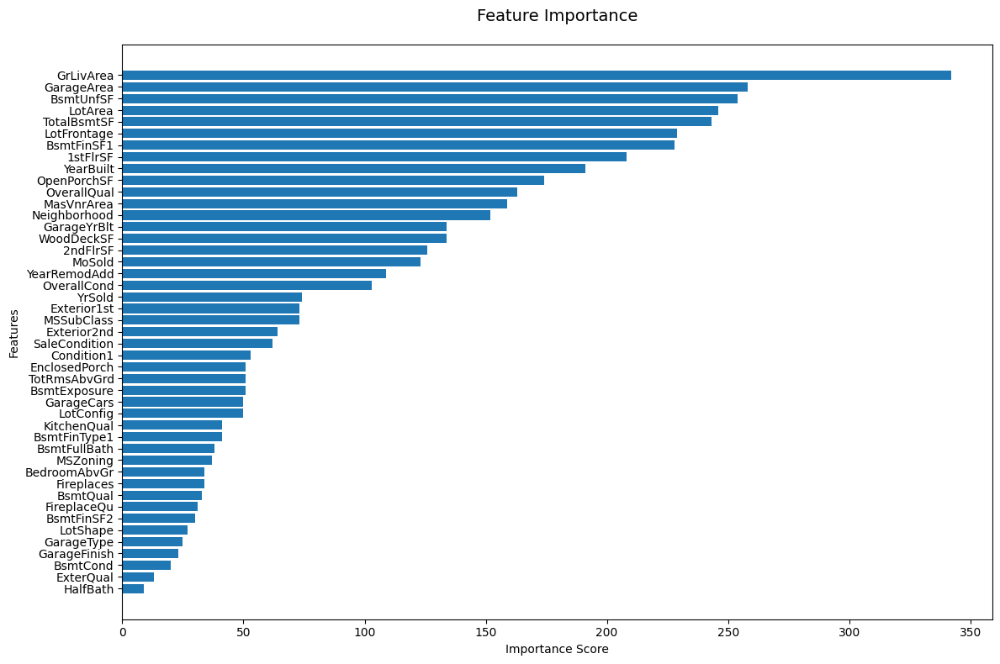

In [25]:
# Plot feature importance for understanding the model
plt.figure(figsize=(12, 8))
feature_importance = pd.DataFrame(
    {"feature": selected_features, "importance": best_model.feature_importances_}
).sort_values("importance", ascending=True)

plt.barh(feature_importance["feature"], feature_importance["importance"])
plt.title("Feature Importance", pad=20, size=14)
plt.xlabel("Importance Score")
plt.ylabel("Features")
plt.tight_layout()

In [26]:
# Make predictions with best model
train_preds = best_model.predict(x_train_processed)
test_preds = best_model.predict(x_test_processed)

In [27]:
# Calculate and print metrics
print("\nTraining Metrics:")
print(f"RMSE: {np.sqrt(mean_squared_error(y_train, train_preds)):.2f}")
print(f"MAE: {mean_absolute_error(y_train, train_preds):.2f}")
print(f"R2: {r2_score(y_train, train_preds):.2f}")

print("\nTest Metrics:")
print(f"RMSE: {np.sqrt(mean_squared_error(y_test, test_preds)):.2f}")
print(f"MAE: {mean_absolute_error(y_test, test_preds):.2f}")
print(f"R2: {r2_score(y_test, test_preds):.2f}")


Training Metrics:
RMSE: 6629.71
MAE: 4710.29
R2: 0.99

Test Metrics:
RMSE: 27007.46
MAE: 16372.43
R2: 0.90


### Kaggle Submission (Optional)

In [ ]:
test_df.drop(["Id"], axis=1)

In [28]:
# Preprocess test data using the same pipeline
kaggle_test_df_processed = preprocessing_pipeline.transform(
    test_df.drop(["Id"], axis=1)
)
kaggle_test_df_processed.head()

,MSSubClass,MSZoning,LotFrontage,LotArea,LotShape,LotConfig,Neighborhood,Condition1,BldgType,HouseStyle,...,GarageCars,GarageArea,GarageQual,WoodDeckSF,OpenPorchSF,EnclosedPorch,MoSold,YrSold,SaleType,SaleCondition
0,20,15.0,80.0,11622,729,822,181,66,978,577,...,1.0,730.0,1050,140,0,0,6,2010,1012.0,964
1,20,924.0,81.0,14267,394,221,181,1004,978,577,...,1.0,312.0,1050,393,36,0,6,2010,1012.0,964
2,60,924.0,74.0,13830,394,822,65,1004,978,360,...,2.0,482.0,1050,212,34,0,3,2010,1012.0,964
3,60,924.0,78.0,9978,394,822,65,1004,978,360,...,2.0,470.0,1050,360,36,0,6,2010,1012.0,964
4,120,924.0,43.0,5005,394,822,20,1004,88,577,...,2.0,506.0,1050,0,82,0,1,2010,1012.0,964


In [29]:
# Make predictions on processed test data
kaggle_test_predictions = best_model.predict(
    kaggle_test_df_processed[selected_features]
)

# Create submission dataframe
submission = pd.DataFrame(
    {"Id": test_df["Id"].values, "SalePrice": kaggle_test_predictions}
)
submission.head()

,Id,SalePrice
0,1461,125868.228845
1,1462,160569.812028
2,1463,182854.784832
3,1464,194342.429732
4,1465,178032.076112


In [30]:
# Check expectations that all rows are present; 1459 expected
submission.shape

(1459, 2)

In [31]:
# Save submission file with timestamp prefix
timestamp = pd.Timestamp.now().strftime("%Y%m%d_%H%M%S")
filename = f"{timestamp}_submission.csv"
submission.to_csv(filename, index=False)
print(f"Submission file '{filename}' created successfully")

Submission file '20250520_211422_submission.csv' created successfully


In [34]:
# import kaggle
# !kaggle competitions submit -c house-prices-advanced-regression-techniques -f {filename} -m "Message"

# # # NOTE: Need to authenticate Kaggle API
# # # https://www.kaggle.com/docs/api

## 5. Counterfactual Explanations

DiCE (Diverse Counterfactual Explanations) is a powerful library that helps us understand how machine learning models make predictions by generating "what-if" scenarios. 
 
 In our house price prediction model, DiCE will help us answer questions like:
 - "What changes would make this house more valuable?"
 - "What features are most important for increasing the predicted price?"
 - "What's the minimum change needed to reach a target price?"

 DiCE works by finding alternative versions of a house (counterfactuals) that would result in different predicted rices. These counterfactuals are:
 - Diverse: They show multiple different ways to achieve the desired outcome
 - Actionable: They suggest realistic changes that could be made
 - Proximate: They make minimal changes to the original features

 This helps homeowners, real estate agents, and buyers understand what factors most influence house prices and what improvements might be most valuable.


In [40]:
# Prepare data for DiCE
dice_x_test = pd.concat(
    [
        x_test_processed,
        pd.Series(test_preds, index=x_test_processed.index, name="predicted_price"),
    ],
    axis=1,
)
dice_x_test.reset_index(drop=True, inplace=True)
dice_x_test

,MSSubClass,MSZoning,LotFrontage,LotArea,LotShape,LotConfig,Neighborhood,Condition1,OverallQual,OverallCond,...,GarageFinish,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,MoSold,YrSold,SaleCondition,predicted_price
0,20,924,70.0,8414,729,822,58,1004,6,8,...,339,1,264,192,0,0,2,2006,964,144184.485930
1,60,924,98.0,12256,394,221,33,1004,8,5,...,339,2,712,186,32,0,4,2010,964,334571.413406
2,30,172,56.0,8960,729,822,91,40,5,6,...,480,2,360,0,0,130,3,2010,964,106460.125145
3,50,172,50.0,5000,729,221,45,66,6,7,...,480,2,420,0,24,36,10,2006,964,158894.679859
4,20,924,89.0,12898,394,822,28,1004,9,5,...,285,3,912,228,0,0,9,2009,964,317874.660820
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
287,30,172,50.0,5925,729,822,91,1004,4,7,...,480,2,672,0,72,0,3,2007,7,120030.840625
288,20,924,124.0,16158,394,822,20,1004,7,5,...,285,2,430,168,36,0,6,2009,964,247255.281786
289,60,924,63.0,8199,729,822,115,1004,7,5,...,285,2,410,36,18,0,10,2008,964,186343.124101
290,70,924,60.0,9084,729,822,87,40,4,5,...,480,1,296,120,0,0,10,2009,964,125922.871438


To generate counterfactual explanations with DiCE, we follow a simple three-step process:

1. **Define the DiCE Data Object** <br>
This wraps our dataset and tells DiCE which features are continuous, categorical, and what the outcome variable is.

2. **Define the DiCE Model Object** <br>
This wraps the trained ML model so DiCE can query it to generate predictions.

3. **Define the Counterfactual Explanation Object** <br>
This is where we specify the instance we want explanations for, the desired outcome, and how many diverse counterfactuals to generate.

In [41]:
# 1. Define the DiCE ML data object
dice_data_obj = dice_ml.Data(
    dataframe=dice_x_test,
    continuous_features=dice_x_test.drop(["predicted_price"], axis=1).columns.tolist(),
    outcome_name="predicted_price",
)
dice_data_obj

In [42]:
# 2. Define the DiCE model object
dice_model = dice_ml.Model(model=best_model, backend="sklearn", model_type="regressor")
dice_model

In [43]:
# 3. Define the counterfactual explanation object
dice_explainer = dice_ml.Dice(dice_data_obj, dice_model, method="random")
dice_explainer

# NOTE:
# - For tree-based models (like LightGBM), "random" and "genetic" are preferrable:
#   1] "random" is fast and simple, but may produce less diverse or optimal counterfactuals.
#      This approach involves randomly changing feature values of the instance of interest and stopping when the desired output is predicted.

#   2] "genetic" is slower, but tends to find better (lower-cost) counterfactuals.

The **random method** implementation as suggested by Wachter et. al (2017) is generating counterfactual by minimising the following loss function:
$$
L(x, x', y', \lambda) = \lambda \cdot \left( \hat{f}(x') - y' \right)^2 + d(x, x')
$$

where:
- first term: quadratic distance between the model prediction for the counterfactual $x’$ and the desired outcome $y’$, that must be defined in advance.
- second term: The second term is the distance $d$ between the instance $x$ to be explained and the counterfactual $x’$.
- $\lambda$ parameter balances the distance in prediction against the distance in feature values.
  - higher value of $\lambda$ means that we prefer counterfactuals that come close to the desired outcome $y’$.
  - lower value means that we prefer counterfactuals $x’$ that are very similar to $x$ in the feature values
- The L1(Manhattan) Distance is used **d**: $d(x, x') = \sum_{j=1}^p \frac{|x_j - x'_j|}{MAD_j}$


The loss is solved for a given $\lambda$ and returns a counterfactual $x’$. <br>
Finally, for how far away the prediction of the counterfactual instance is allowed to be from y’. This constraint can be written as $\left| \hat{f}(x') - y' \right| \leq \epsilon$.

[Source](https://arxiv.org/pdf/1905.07697)

In [44]:
# Select a sample house for counterfactual explanation, you can change this to analyse different houses (or even select a group)
sample_idx = 10

query_instance = x_test_processed.iloc[[sample_idx]]
query_instance

,MSSubClass,MSZoning,LotFrontage,LotArea,LotShape,LotConfig,Neighborhood,Condition1,OverallQual,OverallCond,...,GarageYrBlt,GarageFinish,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,MoSold,YrSold,SaleCondition
576,50,924,52.0,6292,729,822,21,1004,7,7,...,1928.0,480,1,216,0,50,0,8,2009,964


In [45]:
# Get current prediction for the pre-selected house
current_price = best_model.predict(query_instance)[0]
print(f"Current predicted price: ${current_price:,.2f}")

Current predicted price: $147,364.09


In [46]:
# Generate counterfactuals
cf_examples = dice_explainer.generate_counterfactuals(
    query_instance,
    total_CFs=3,
    desired_range=(current_price * 1.1, current_price * 1.2),  # 10-20% higher price
    features_to_vary=["GrLivArea", "OverallQual", "YearBuilt"],
)

# Display counterfactuals
cf_examples.visualize_as_dataframe(show_only_changes=True)

100%|██████████| 1/1 [00:00<00:00, 10.39it/s]

Query instance (original outcome : 147364.0)


,MSSubClass,MSZoning,LotFrontage,LotArea,LotShape,LotConfig,Neighborhood,Condition1,OverallQual,OverallCond,...,GarageFinish,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,MoSold,YrSold,SaleCondition,predicted_price
0,50,924,52.0,6292,729,822,21,1004,7,7,...,480,1,216,0,50,0,8,2009,964,147364.0



Diverse Counterfactual set (new outcome: (162100.49923357944, 176836.9082548139))


,MSSubClass,MSZoning,LotFrontage,LotArea,LotShape,LotConfig,Neighborhood,Condition1,OverallQual,OverallCond,...,GarageFinish,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,MoSold,YrSold,SaleCondition,predicted_price
0,-,-,-,-,-,-,-,-,8.0,-,...,-,-,-,-,-,-,-,-,-,-
1,-,-,-,-,-,-,-,-,-,-,...,-,-,-,-,-,-,-,-,-,-
2,-,-,-,-,-,-,-,-,8.0,-,...,-,-,-,-,-,-,-,-,-,-


In [47]:
# The example that was passed
cf_examples.cf_examples_list[0].test_instance_df.iloc[[0]][
    ["GrLivArea", "OverallQual", "YearBuilt", "predicted_price"]
]

,GrLivArea,OverallQual,YearBuilt,predicted_price
0,1477,7,1928,147364.0


In [48]:
# Explore the counterfactuals
cf_examples.cf_examples_list[0].final_cfs_df[
    ["GrLivArea", "OverallQual", "YearBuilt", "predicted_price"]
]

,GrLivArea,OverallQual,YearBuilt,predicted_price
0,1477,8,1993,175286.0
1,1858,7,1928,172239.0
2,1790,8,1928,172337.0


### 🔍 Interpreting the Counterfactual Explanations

Below, we analyze a single prediction from our model and explore three counterfactual scenarios generated using DiCE.

#### 📌 Original Instance
The original house has:
- **GrLivArea**: 1477 sq ft  
- **OverallQual**: 7  
- **YearBuilt**: 1928  
- **Predicted Price**: \$147,364  

#### 🔁 Counterfactual Examples
DiCE generated three diverse counterfactuals that increase the predicted price by **10–20%**, each requiring realistic and minimal changes:

| Counterfactual | GrLivArea | OverallQual | YearBuilt | Predicted Price |
|----------------|-----------|-------------|-----------|-----------------|
| #1             | 1477      | **8**       | **1993**  | \$175,286       |
| #2             | **1858**  | 7           | 1928      | \$172,239       |
| #3             | **1790**  | 8           | 1928      | \$172,337       |

These counterfactuals demonstrate:
- Improving the **Overall Quality** of the house can significantly increase its value.
- Increasing **living area** (GrLivArea) is another effective lever.
- A newer **YearBuilt** (e.g., from 1928 to 1993) can positively impact the predicted price.

This provides actionable insights for homeowners or sellers on what changes might lead to a higher property valuation.